# Проект APP (auto price predictor): 
**Сервис по продаже автомобилей с пробегом разрабатывает приложение, чтобы привлечь новых клиентов. В нём можно будет узнать рыночную стоимость своего автомобиля.**

### Цель проекта
**Разработать модель для предсказания рыночной стоимости авто на основании данных о технических характеристиках, комплектации и ценах других автомобилей**

- **Важные критерии:**
    - качество предсказания;
    - время обучения модели;
    - время предсказания модели.


### Этапы:

#### [1. Обзор данных](#load)
- **Загрузить и проанализировать входные данные**

#### [2. Предобработка](#data_preprocessing)
- **Проверить на пропуски и дубликаты**
- **Выявить другие проблемы с данными**

#### [3. Провести исследовательский анализ данных (EDA)](#eda)
- **Изучить распределение признаков**
- **Провести корреляционный анализ признаков**

#### [4. Моделирование](#model)
- **Построить pipeline для выбора модели и гиперпарамиетров**
- **Провести подбор гиперпараметров моделей LightGBM, DecisionTreeRegressor, SVR**
- **Оценить RMSE лучшей модели**
- **Интерпретировать результаты**

#### [8. Выводы](#conclusion)

## Описание данных
Файл `autos.csv` содержит информацию о выставленных на продажу автомобилях.  

- **DateCrawled** — дата скачивания анкеты из базы  
- **VehicleType** — тип автомобильного кузова  
- **RegistrationYear** — год регистрации автомобиля  
- **Gearbox** — тип коробки передач  
- **Power** — мощность (л. с.)  
- **Model** — модель автомобиля  
- **Kilometer** — пробег (км)  
- **RegistrationMonth** — месяц регистрации автомобиля  
- **FuelType** — тип топлива  
- **Brand** — марка автомобиля  
- **Repaired** — была машина в ремонте или нет  
- **DateCreated** — дата создания анкеты  
- **NumberOfPictures** — количество фотографий автомобиля  
- **PostalCode** — почтовый индекс владельца анкеты  
- **LastSeen** — дата последней активности пользователя  

**Целевой признак**  
- **Price** — цена (евро)  

## Импорт библиотек

In [1]:
%pip install -U -q scikit-learn
%pip install phik -q
%pip install lightgbm -q
%pip install shap -q

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import os
import warnings
import re

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import display

from sklearn import set_config
from sklearn.linear_model import LinearRegression
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeRegressor
from sklearn.impute import SimpleImputer
from sklearn.metrics import root_mean_squared_error
from sklearn.model_selection import (
    train_test_split,
    RandomizedSearchCV)
from sklearn.neighbors import KNeighborsRegressor
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import (
    OneHotEncoder,
    StandardScaler,
    MinMaxScaler,
    RobustScaler
)

import lightgbm as lgb
from lightgbm import early_stopping

import phik
import shap

RANDOM_STATE = 42
TEST_SIZE = 0.25

In [3]:
# задаем настройки pandas
pd.set_option('display.float_format', '{:.4f}'.format)

# задаем настройки среды визуализации
%config InlineBackend.figure_format = 'svg' 
%matplotlib inline

sns.set(style="whitegrid", font_scale=1, rc={"figure.figsize": (8, 6)})

set_config(display="diagram")

warnings.filterwarnings('ignore')

<a id="load"></a>
## Обзор данных

In [4]:
# загружаем датасеты
pth = '/datasets/autos.csv'
pth_alt = r"C:\Users\User\da_practicum\local_projects\10 цена авто\data\autos.csv"

if os.path.exists(pth):
    data = pd.read_csv(pth)
elif os.path.exists(pth_alt):
    data = pd.read_csv(pth_alt)
else:
    print('Something is wrong')
    data = None

data.shape

(354369, 16)

In [5]:
# определим функцию для вывода общей информации о датасете
def displ(data, title='Обзорная информация', obj=True, discr=True):
    """
    Функция для вывода общей информации о датасете
    """

    print(f'----------{title}----------\n')

    display(data.info())
    print(f'-------Датафрейм-------\n')
    display(data.head(5))
    if discr:
        print(f'-------Описательные статистики для количественных признаков-------\n')
        display(data.describe().T)
    if obj:
        print(f'-------Описательные статистики для категориальных признаков-------\n')
        display(data.describe(include='object').T)
    
    #определене пропусков
    print(f'-------Количество и процент пропусков-------\n')
    display(pd.DataFrame({
            'Кол-во пропусков': data.isna().sum(),
            'Процент пропусков': round(data.isna().mean() * 100, 2)
            })
            .loc[data.isna().sum() > 0]
            .sort_values(by='Процент пропусков', ascending=False))

In [6]:
displ(data)

----------Обзорная информация----------

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354369 entries, 0 to 354368
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   DateCrawled        354369 non-null  object
 1   Price              354369 non-null  int64 
 2   VehicleType        316879 non-null  object
 3   RegistrationYear   354369 non-null  int64 
 4   Gearbox            334536 non-null  object
 5   Power              354369 non-null  int64 
 6   Model              334664 non-null  object
 7   Kilometer          354369 non-null  int64 
 8   RegistrationMonth  354369 non-null  int64 
 9   FuelType           321474 non-null  object
 10  Brand              354369 non-null  object
 11  Repaired           283215 non-null  object
 12  DateCreated        354369 non-null  object
 13  NumberOfPictures   354369 non-null  int64 
 14  PostalCode         354369 non-null  int64 
 15  LastSeen           354369 n

None

-------Датафрейм-------



,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,Repaired,DateCreated,NumberOfPictures,PostalCode,LastSeen
0,2016-03-24 11:52:17,480,NaN,1993,manual,0,golf,150000,0,petrol,volkswagen,NaN,2016-03-24 00:00:00,0,70435,2016-04-07 03:16:57
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,NaN,125000,5,gasoline,audi,yes,2016-03-24 00:00:00,0,66954,2016-04-07 01:46:50
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,jeep,NaN,2016-03-14 00:00:00,0,90480,2016-04-05 12:47:46
3,2016-03-17 16:54:04,1500,small,2001,manual,75,golf,150000,6,petrol,volkswagen,no,2016-03-17 00:00:00,0,91074,2016-03-17 17:40:17
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,skoda,no,2016-03-31 00:00:00,0,60437,2016-04-06 10:17:21


-------Описательные статистики для количественных признаков-------



,count,mean,std,min,25%,50%,75%,max
Price,354369.0000,4416.6568,4514.1585,0.0000,1050.0000,2700.0000,6400.0000,20000.0000
RegistrationYear,354369.0000,2004.2344,90.2280,1000.0000,1999.0000,2003.0000,2008.0000,9999.0000
Power,354369.0000,110.0943,189.8504,0.0000,69.0000,105.0000,143.0000,20000.0000
Kilometer,354369.0000,128211.1725,37905.3415,5000.0000,125000.0000,150000.0000,150000.0000,150000.0000
RegistrationMonth,354369.0000,5.7146,3.7264,0.0000,3.0000,6.0000,9.0000,12.0000
NumberOfPictures,354369.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
PostalCode,354369.0000,50508.6891,25783.0962,1067.0000,30165.0000,49413.0000,71083.0000,99998.0000


-------Описательные статистики для категориальных признаков-------



,count,unique,top,freq
DateCrawled,354369,271174,2016-03-24 14:49:47,7
VehicleType,316879,8,sedan,91457
Gearbox,334536,2,manual,268251
Model,334664,250,golf,29232
FuelType,321474,7,petrol,216352
Brand,354369,40,volkswagen,77013
Repaired,283215,2,no,247161
DateCreated,354369,109,2016-04-03 00:00:00,13719
LastSeen,354369,179150,2016-04-06 13:45:54,17


-------Количество и процент пропусков-------



,Кол-во пропусков,Процент пропусков
Repaired,71154,20.0800
VehicleType,37490,10.5800
FuelType,32895,9.2800
Gearbox,19833,5.6000
Model,19705,5.5600


***Выводы по обзору:***

- ***Типы данных соответствуют признакам.***

- ***Присутствуют аномальные значения в столбцах `Price` (цена 0 евро), `RegistrationYear` (год регистрации 1000 и 9999), `Power` (мощность авто 0), `NumberOfPictures` (все значения в столбце равны 0. Столбец неинформативен).***

- ***В столбцах `repaired, vehicle_type, fuel_type, gearbox, model` присутствуют пропущенные значения.***

<a id="data_preprocessing"></a>
## Предобработка

### Функции для предобработки

In [7]:
def check_dupl(df):
    '''
    Проверяет наличие дубликатов. Выводит на экран, если есть.
    '''
    
    print(f"Количество полных дубликатов: {df.duplicated().sum()}")
    if df.duplicated().sum() > 0:
        # покажем дубликаты
        display(df.loc[df.duplicated(keep='first')].head(5))

In [8]:
def check_implicit_dupl(df):
    '''
    Выводит уникальные значения в столбцах object
    '''
    for col in df.select_dtypes(['object']).columns:
        print(col,':', df[col].unique(), 'количество уникальных значений:', df[col].nunique(), '\n')

### Переименование столбцов

In [9]:
data.columns = [re.sub(r'(?<!^)(?=[A-Z])', '_', i).lower() for i in data.columns]
data.columns

Index(['date_crawled', 'price', 'vehicle_type', 'registration_year', 'gearbox',
       'power', 'model', 'kilometer', 'registration_month', 'fuel_type',
       'brand', 'repaired', 'date_created', 'number_of_pictures',
       'postal_code', 'last_seen'],
      dtype='object')

In [10]:
data.head(5)

,date_crawled,price,vehicle_type,registration_year,gearbox,power,model,kilometer,registration_month,fuel_type,brand,repaired,date_created,number_of_pictures,postal_code,last_seen
0,2016-03-24 11:52:17,480,NaN,1993,manual,0,golf,150000,0,petrol,volkswagen,NaN,2016-03-24 00:00:00,0,70435,2016-04-07 03:16:57
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,NaN,125000,5,gasoline,audi,yes,2016-03-24 00:00:00,0,66954,2016-04-07 01:46:50
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,jeep,NaN,2016-03-14 00:00:00,0,90480,2016-04-05 12:47:46
3,2016-03-17 16:54:04,1500,small,2001,manual,75,golf,150000,6,petrol,volkswagen,no,2016-03-17 00:00:00,0,91074,2016-03-17 17:40:17
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,skoda,no,2016-03-31 00:00:00,0,60437,2016-04-06 10:17:21


- ***Удалим неинформативные столбцы: `date_crawled, date_created, number_of_pictures, postal_code, last_seen`.***
        
        
- ***Даты регистрации стоимость авто, не зависит от даты регистрации анкеты, когда эта анкета была создана и скачана. Так же не зависит от последнего посещение сайта пользователем.***

- ***Месяц регистрации сомого авто так же неинформативен, т.к. на возраст указывает столбец `year`.***

- ***Почтовый индекс владельца не влияет на стоимость авто.***

In [11]:
auto_pre = data.copy()
auto_pre = auto_pre.drop(['date_crawled',
                          'date_created',
                          'number_of_pictures',
                          'postal_code',
                          'last_seen',
                          'registration_month'], axis=1)
auto_pre

,price,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
0,480,NaN,1993,manual,0,golf,150000,petrol,volkswagen,NaN
1,18300,coupe,2011,manual,190,NaN,125000,gasoline,audi,yes
2,9800,suv,2004,auto,163,grand,125000,gasoline,jeep,NaN
3,1500,small,2001,manual,75,golf,150000,petrol,volkswagen,no
4,3600,small,2008,manual,69,fabia,90000,gasoline,skoda,no
...,...,...,...,...,...,...,...,...,...,...
354364,0,NaN,2005,manual,0,colt,150000,petrol,mitsubishi,yes
354365,2200,NaN,2005,NaN,0,NaN,20000,NaN,sonstige_autos,NaN
354366,1199,convertible,2000,auto,101,fortwo,125000,petrol,smart,no
354367,9200,bus,1996,manual,102,transporter,150000,gasoline,volkswagen,no


### Обработка дубликатов
- **Проверим на полные дубликаты.**

In [12]:
check_dupl(auto_pre)

Количество полных дубликатов: 45040


,price,vehicle_type,registration_year,gearbox,power,model,kilometer,fuel_type,brand,repaired
1117,950,small,1999,manual,60,polo,150000,petrol,volkswagen,no
1396,0,NaN,2000,NaN,0,NaN,150000,NaN,volvo,NaN
2169,0,coupe,2002,manual,129,c_klasse,150000,petrol,mercedes_benz,no
2833,1499,small,2001,manual,58,corsa,150000,petrol,opel,no
3025,2800,wagon,2005,NaN,0,touran,150000,gasoline,volkswagen,no


- ***Полные дубликаты удалим после всех обработок датафрейма.***

- **Выведем уникальные значения категориальных признаков, чтобы проверить на частичные дубликаты или опечатки.**

In [13]:
check_implicit_dupl(auto_pre)

vehicle_type : [nan 'coupe' 'suv' 'small' 'sedan' 'convertible' 'bus' 'wagon' 'other'] количество уникальных значений: 8 

gearbox : ['manual' 'auto' nan] количество уникальных значений: 2 

model : ['golf' nan 'grand' 'fabia' '3er' '2_reihe' 'other' 'c_max' '3_reihe'
 'passat' 'navara' 'ka' 'polo' 'twingo' 'a_klasse' 'scirocco' '5er'
 'meriva' 'arosa' 'c4' 'civic' 'transporter' 'punto' 'e_klasse' 'clio'
 'kadett' 'kangoo' 'corsa' 'one' 'fortwo' '1er' 'b_klasse' 'signum'
 'astra' 'a8' 'jetta' 'fiesta' 'c_klasse' 'micra' 'vito' 'sprinter' '156'
 'escort' 'forester' 'xc_reihe' 'scenic' 'a4' 'a1' 'insignia' 'combo'
 'focus' 'tt' 'a6' 'jazz' 'omega' 'slk' '7er' '80' '147' '100' 'z_reihe'
 'sportage' 'sorento' 'v40' 'ibiza' 'mustang' 'eos' 'touran' 'getz' 'a3'
 'almera' 'megane' 'lupo' 'r19' 'zafira' 'caddy' 'mondeo' 'cordoba' 'colt'
 'impreza' 'vectra' 'berlingo' 'tiguan' 'i_reihe' 'espace' 'sharan'
 '6_reihe' 'panda' 'up' 'seicento' 'ceed' '5_reihe' 'yeti' 'octavia' 'mii'
 'rx_reihe' '6er

- **Обработаем неявные дубликаты.**

In [14]:
replacements_models = {
    # BMW
    '1_reihe': 'serie_1',
    '2_reihe': 'serie_2',
    '3_reihe': 'serie_3',
    '5_reihe': 'serie_5',
    '6_reihe': 'serie_6',
    '7er': 'serie_7',
    '1er': 'serie_1',
    '2er': 'serie_2',
    '3er': 'serie_3',

    # Mercedes
    'gl': 'g_klasse',
    'glk': 'g_klasse',
    'viano': 'v_klasse',

    # Citroën
    'c1': 'c_klasse',
    'c2': 'c_klasse',
    'c3': 'c_klasse',
    'c4': 'c_klasse',
    'c5': 'c_klasse',

    # Chrysler
    '300c': 'chrysler_300c',
    '200': 'chrysler_200',

    # Range Rover
    'rangerover': 'range_rover'
}

fuel_replacements = {
    'gasoline': 'petrol'
}

auto_pre['model'] = auto_pre['model'].replace(replacements_models)
auto_pre['fuel_type'] = auto_pre['fuel_type'].replace(fuel_replacements)

### Обработка пропусков

- **Авто одинаковых марок могут иметь разную комплектацию и значительно отличаться в цене. Заполним пропущенные значения "заглушками", чтобы модель точно предсказывала цену, когда данные по авто полные. А в случае неполных данных модель будет давать более усредненную оценку.**

In [15]:
auto_pre=auto_pre.fillna('unknown')

In [16]:
# проверка
pd.DataFrame({
            'Кол-во пропусков': auto_pre.isna().sum(),
            'Процент пропусков': round(auto_pre.isna().mean() * 100, 2)
            }).sort_values(by='Процент пропусков', ascending=False)

,Кол-во пропусков,Процент пропусков
price,0,0.0000
vehicle_type,0,0.0000
registration_year,0,0.0000
gearbox,0,0.0000
power,0,0.0000
model,0,0.0000
kilometer,0,0.0000
fuel_type,0,0.0000
brand,0,0.0000
repaired,0,0.0000


### Обработка аномальных значений

In [17]:
def show_title(title, x_label, y_label, ax=None, rot=False, file_name=None):
    '''
    Функция добавляет заголовок, подписи осей, вращение подписей осей.
    '''
    
    # задаем название графика, названия осей
    ax.set_title(title)    
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    
    # поворот названий осей
    if rot:
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    # сохраним картинку
    if file_name:
        plt.savefig(file_name)

In [18]:
def boxplot(data):
    """
    Функция для построения графиков распределения
    """
    fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(10, 5))
    axes = axes.flatten()
    # выделим количественные признаки
    num_column_list = data.select_dtypes(['int64', 'float64']).columns.tolist()
    label = ['Цена, евро', 'Год регистрации', 'Мощность, (л. с.)', 'Пробег, км']
    # строим графики
    for ax, col, l in zip(axes, num_column_list, label):
        sns.boxplot(data=data,  y=col, ax=ax)

        # подписи графиков
        show_title(title=col,
                x_label='',
                y_label=l,
                ax=ax)

    for ax in axes[len(num_column_list):]:
        fig.delaxes(ax)    

    # axes[0].set_ylabel('Значение признака')    
    fig.suptitle('Распределения количественных признаков')
    plt.tight_layout()
    plt.show()

In [19]:
boxplot(auto_pre)

***Имеются аномальные значения в столбцах `price, registration_year, power`. Удалим аномальные значения, для того чтобы не понижать качество данных.***

***В столбце `kilimeter` есть авто с малым пробегом. Такие значения возможны, удалять или заменять их не будем.***

In [20]:
def remove_anomaly(data, column, max_val=None, min_val=None):
    """
    Функция удаления аномалий
    """
    
    mask = True
    if min_val:
        mask = mask & (data[column] >= min_val)
    if max_val:
        mask = mask & (data[column] <= max_val)
    
    return data[mask].copy()

In [21]:
auto = auto_pre.copy()

- **В столбце `price` удалим значения, выходящие за грацины 3 сигм (сверху) как наиболее нетипичные. Нижнюю границу зададим 500 евро, основываясь на исторических данных.**

In [22]:
auto = remove_anomaly(data=auto,
                      column='price',
                      max_val=data['price'].mean() + 3 * data['price'].std(),
                      min_val=500)

- **В столбце `registration_year` удалим значения менее 1980 года (для более ранних данных наблюдений может быть недостаточно, к тому же старые автомобили могут иметь другое ценообразование) и более 2016 (т.к. данные получены включительно по этот год)**

In [23]:
auto = remove_anomaly(data=auto,
                     column='registration_year',
                     min_val=1980,
                     max_val=2016)

- **В столбце `power` удалим значения менее 50 л.с. (как минимальныя граница для малых авто) и более 600 л.с. (как максимальныя граница для крупных внедорожников)**

In [24]:
auto = remove_anomaly(data=auto,
                     column='power',
                     min_val=50,
                     max_val=600)

In [25]:
# проверка
boxplot(auto)

***В результате предобработки заполнены пропуски, обработаны аномальные значения.***

### Удаление дубликатов

In [26]:
auto = auto.drop_duplicates()

In [27]:
check_dupl(auto)

Количество полных дубликатов: 0


<a id="EDA"></a>
## EDA

### Распределения количественных признаков
- **Изучим распределения количественных признаков.**

In [28]:
num_column_list = auto.columns[auto.nunique() >= 20].tolist()
cat_column_list = auto.columns[auto.nunique() < 20].tolist()
num_column_list, cat_column_list

(['price', 'registration_year', 'power', 'model', 'brand'],
 ['vehicle_type', 'gearbox', 'kilometer', 'fuel_type', 'repaired'])

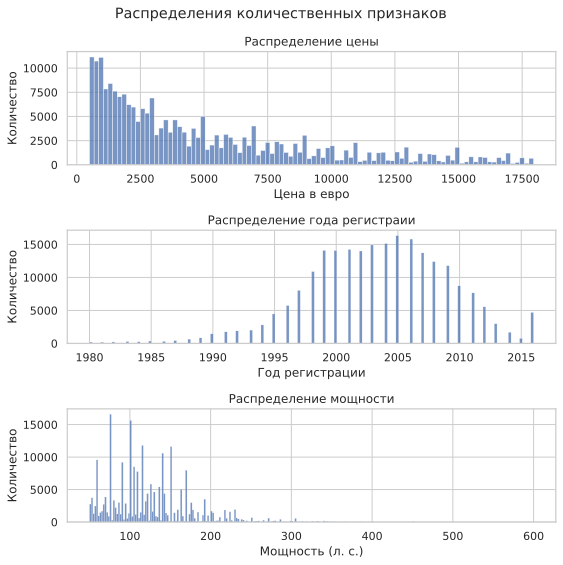

In [29]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(8, 8))
axes = axes.flatten()

title = [['Распределение цены', 'Цена в евро', 'Количество'],
         ['Распределение года регистраии', 'Год регистрации', 'Количество'],
         ['Распределение мощности', 'Мощность (л. с.)', 'Количество']
        ]

# строим графики
for ax, col, title in zip(axes, num_column_list[:-2], title):
    sns.histplot(data=auto,
                x=col,
                palette='mako',
                ax=ax
                )


    show_title(title=title[0],
           x_label=title[1],
           y_label=title[2],
           ax=ax)    
    
fig.suptitle('Распределения количественных признаков')
plt.tight_layout()
plt.show()

- ***Цена имеет смещенное влево распределение. Средняя цена авто около 1500 евро.***

- ***Год регистрации имеет смещенное вправо распределение, с несколькими максимумами. Наиболее часто встречающийся авто - 2000 года.***

- ***Мощность имеет неравномерное распределение. Максимум около 75 л. с.***

### Распределения категориальных признаков

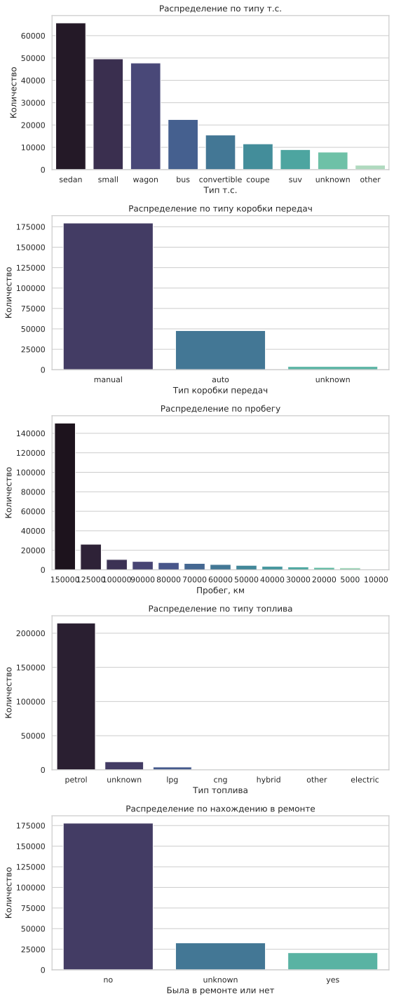

In [30]:
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(8, 20))
axes = axes.flatten()

title = [['Распределение по типу т.с.', 'Тип т.с.'], 
        ['Распределение по типу коробки передач', 'Тип коробки передач'],
        ['Распределение по пробегу', 'Пробег, км'],
        ['Распределение по типу топлива', 'Тип топлива'],
        ['Распределение по нахождению в ремонте', 'Была в ремонте или нет']]

# строим графики
for ax, col, title in zip(axes, cat_column_list, title):
    sns.countplot(data=auto,
                 x=col,
                 palette='mako',
                 order=auto[col].value_counts().index,
                 ax=ax
                )
    
    # подписи графиков
    show_title(title=title[0],
               x_label=title[1],
               y_label='Количество',
               ax=ax)  

plt.tight_layout()
plt.show()

- ***Чаще всего на продажу выставляют седаны с ручной коробкой передач, с больщим пробегом (150000 км), на бензине, которые не быле в ремонте.***

- **Определим самые продающиеся бренды авто.**

In [31]:
auto_aggr = (auto
             .pivot_table(index=['brand', 'model'], values='price', aggfunc=['mean', 'count']))
auto_aggr.columns = ['mean_price', 'count']
auto_aggr = auto_aggr.reset_index()

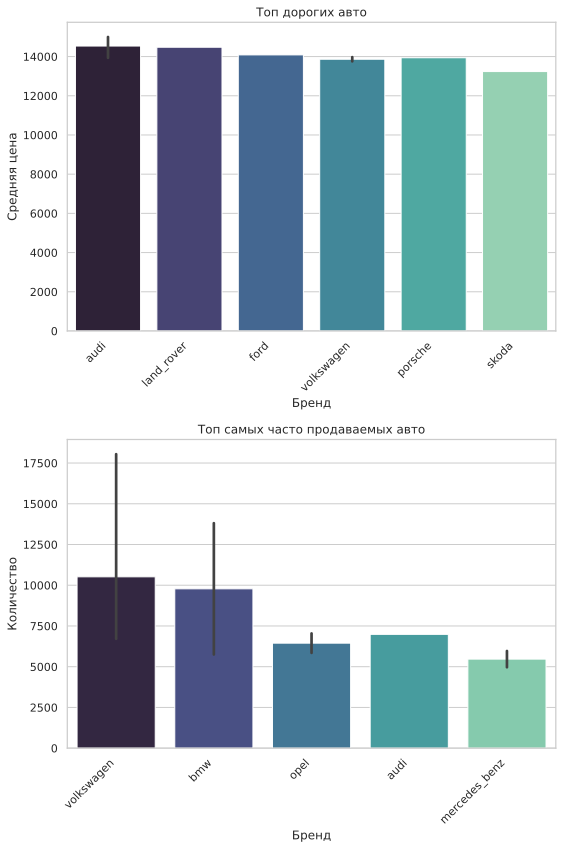

In [32]:
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(8, 12))
axes = axes.flatten()

title = [['Топ дорогих авто', 'Бренд', 'Средняя цена'], 
        ['Топ самых часто продаваемых авто', 'Бренд', 'Количество']]

# строим графики
for ax, col, title in zip(axes, ['mean_price', 'count'], title):
    sns.barplot(data=auto_aggr.sort_values(col, ascending=False).head(10),
                 x='brand',
                 y=col,
                 palette='mako',
                 ax=ax
                )

    # подписи графиков
    show_title(title=title[0],
               x_label=title[1],
               y_label=title[2],
               ax=ax,
               rot=True)
      
plt.tight_layout()
plt.show()

- ***Самые дорогие по средней стоимости авто бренды: audi, land_rover, ford***

- ***Самые часто продаваемые: volkswagen, bmw, audi.***

### Диаграммы разброса
- **Построим диаграммы разброса зависимостей количественных признаков от цены авто.**

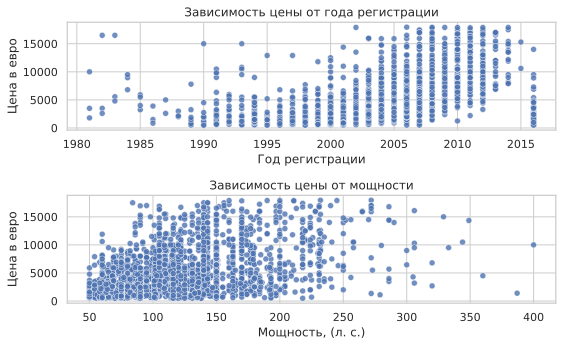

In [33]:
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(8, 5))
axes = axes.flatten()

title = ['Зависимость цены от года регистрации', 'Зависимость цены от мощности']
num_column_list = ['registration_year', 'power']
label = ['Год регистрации', 'Мощность, (л. с.)']

for ax, col, title, l in zip(axes, num_column_list, title, label):
    sns.scatterplot(data=auto.sample(n=2500, random_state=RANDOM_STATE),
                    x=col,
                    y='price',
                    alpha=0.8,
                    ax=ax)
    
    #подписи
    show_title(title=title,
           x_label=l,
           y_label='Цена в евро',
           ax=ax)
    
plt.tight_layout()
plt.show()

- ***Прослеживается тенденция: чем новее авто, тем за большуй цену его продают. Зависимость не линейная.***

- ***В основном в продаже авто с малой мощностью, цены на них ниже.***

### Корреляционный анализ
- **Проведем корреляционный анализ признаков.**

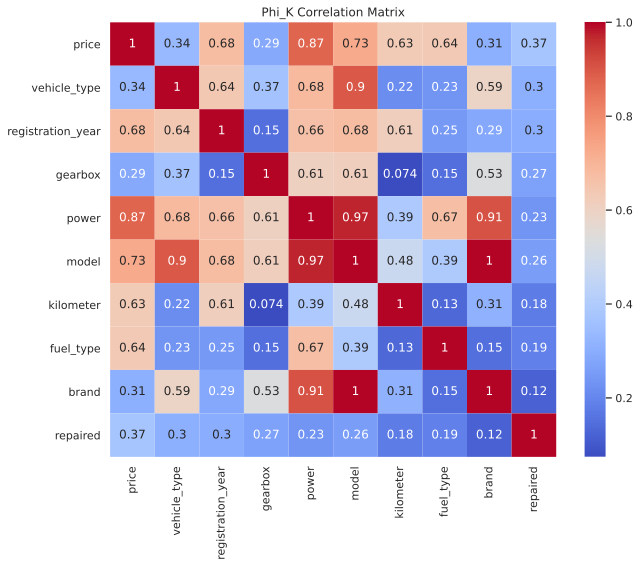

In [34]:
# Вычисление матрицы корреляции с использованием phik
corr_matrix = (auto
               .sample(frac=0.07, random_state=RANDOM_STATE) # подвыборка для уменьшения времени расчета
               .phik_matrix(interval_cols=num_column_list[:-2]))

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Phi_K Correlation Matrix')
plt.show()

***Признаки `model` и `brand`, `power` имеют высокую корреляцию. Чтобы иключить влияние мультиколлениарных признаков удалим столбец `brand`. Сложим столбцы `model` и `brand` в один признак.***

In [35]:
auto['brand_model'] = auto['brand'] + '_' + auto['model']

In [36]:
auto = auto.drop(['brand', 'model'], axis=1)
auto.head(5)

,price,vehicle_type,registration_year,gearbox,power,kilometer,fuel_type,repaired,brand_model
2,9800,suv,2004,auto,163,125000,petrol,unknown,jeep_grand
3,1500,small,2001,manual,75,150000,petrol,no,volkswagen_golf
4,3600,small,2008,manual,69,90000,petrol,no,skoda_fabia
5,650,sedan,1995,manual,102,150000,petrol,yes,bmw_serie_3
6,2200,convertible,2004,manual,109,150000,petrol,no,peugeot_serie_2


In [37]:
auto.duplicated().sum()

0

### Выводы по EDA:
- ***Цена имеет смещенное влево распределение. Средняя цена авто около 1500 евро.***

- ***Год регистрации имеет смещенное вправо распределение, с несколькими максимумами. Наиболее часто встречающийся авто - 2000 года.***

- ***Мощность имеет неравномерное распределение. Максимум около 75 л. с.***

- ***Чаще всего на продажу выставляют седаны с ручной коробкой передач, с больщим пробегом (150000 км), на бензине, которые не быле в ремонте.***

- ***Самые дорогие по средней стоимости авто бренды: audi, land_rover, ford.***

- ***Самые часто продаваемые: volkswagen, bmw, opel.***

- ***Прослеживается тенденция: чем новее авто, тем за большуй цену его продают. Зависимость не линейная.***

- ***В основном в продаже авто с малой мощностью, цены на них ниже.***

- ***Удален столбец `brand`, `power`, коррелирующий с `model`.***

---

#### "Портрет" самого продаваемого авто:
    
- Бензновый volkswagen, bmw или opel
- Средняя цена 1500 евро.
- 2000 г. регистрации.
- Мощностью 75 л. с.
- На ручной коробке передач.
- Не был в ремонте.

---

#### Ркомендации:
- Усовершенствовать сбор параметров авто (исключить повторения, неверное заполнение параметров, пропуски)
- Не собирать неинформативные данные для анализа.
- Параметр NumberOfPictures содержал только 0. Выявить проблему.

<a id="model"></a>
## Моделирование
- **Постоим модель для предсказания цены авто.**
- **Выберем лучшую модель из LightGBM, LinearRegression, DecisionTree, KNeighbors.**
- **В качестве метрики выберем RMSE. Критерий успеха RMSE < 2500.**

In [38]:
# Категориальные признаки для бустингов
cat_features = auto.select_dtypes(include=['object', 'category']).columns.tolist()
auto[cat_features] = auto[cat_features].astype('category')

In [39]:
auto = auto.sample(frac=0.1, random_state=RANDOM_STATE)

In [40]:
auto.shape

(23142, 9)

In [41]:
def make_pipeline(df, target):

    '''
    Функция готовит пайплпйн
    '''

    X = df.drop(target, axis=1)
    y = df[target]

    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42
    )

    # выделяем признаки для кодирования
    ohe_columns = X_train.select_dtypes(include=['category']).columns.tolist()
    num_columns = X_train.select_dtypes(include=['float64', 'int64']).columns.tolist()

    # для бинарных признаков
    ohe_pipe = Pipeline(
        [('SimpleImputer_before_ohe', SimpleImputer(strategy='most_frequent')),
        ('ohe', OneHotEncoder(drop='first', handle_unknown='ignore', sparse_output=False))
        ]
    )

    # для количественных признаков
    num_pipe = Pipeline(
        [('imputer', SimpleImputer(strategy='mean')),
        ('num', MinMaxScaler())
        ]
    )

    # для обработки всех признаков
    preprocessor = ColumnTransformer(
        [('ohe', ohe_pipe, ohe_columns),
        ('num', num_pipe, num_columns)
        ],
        remainder='passthrough'
    )

    # финальный пайплайн
    pipe_final = Pipeline(
        [('preprocessor', preprocessor),
        ('models', LinearRegression())]
    )

    return pipe_final, X_train, y_train, X_test, y_test, preprocessor

In [42]:
param_grid = [
    {
        'models': [DecisionTreeRegressor(random_state=RANDOM_STATE)],
        'models__max_depth': range(10, 15),
        'models__min_samples_leaf': range(1, 5),
        'preprocessor__num': [StandardScaler(), MinMaxScaler(), RobustScaler(), 'passthrough']
    },

    {
        'models': [LinearRegression()],
        'preprocessor__num': [StandardScaler(), MinMaxScaler(), RobustScaler()]
    },
    
    {
        'models': [lgb.LGBMRegressor(
            objective='regression',
            metric='rmse',
            categorical_feature=cat_features,
            verbosity=-1,
            boosting_type='gbdt',
            random_state=RANDOM_STATE,
            n_estimators=10000
        )],
        'models__learning_rate': [0.01, 0.05],
        'models__max_depth': [3, 4],
        'models__num_leaves': [30, 40],
        'preprocessor': ['passthrough']
    },
    
    {
        'models': [KNeighborsRegressor()],
        'models__n_neighbors': range(5, 15),
        'preprocessor__num': [StandardScaler(), MinMaxScaler(), RobustScaler()]
    }
]

### Подбор гиперпараметров и обучение

In [43]:
pipe_final, X_train, y_train, X_test, y_test, preprocessor = make_pipeline(auto, 'price')

search = RandomizedSearchCV(
    pipe_final,
    param_grid,
    cv=5,
    scoring='neg_root_mean_squared_error',
    n_jobs=-1,
    n_iter=100,
    verbose=2
)

search.fit(X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits
[CV] END models=KNeighborsRegressor(), models__n_neighbors=14, preprocessor__num=MinMaxScaler(); total time=   1.2s
[CV] END models=KNeighborsRegressor(), models__n_neighbors=14, preprocessor__num=MinMaxScaler(); total time=   0.9s
[CV] END models=KNeighborsRegressor(), models__n_neighbors=14, preprocessor__num=MinMaxScaler(); total time=   0.9s
[CV] END models=KNeighborsRegressor(), models__n_neighbors=14, preprocessor__num=MinMaxScaler(); total time=   0.9s
[CV] END models=KNeighborsRegressor(), models__n_neighbors=14, preprocessor__num=MinMaxScaler(); total time=   0.9s
[CV] END models=DecisionTreeRegressor(random_state=42), models__max_depth=14, models__min_samples_leaf=2, preprocessor__num=passthrough; total time=   0.4s
[CV] END models=DecisionTreeRegressor(random_state=42), models__max_depth=14, models__min_samples_leaf=2, preprocessor__num=passthrough; total time=   0.4s
[CV] END models=DecisionTreeRegressor(random_

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('ohe',
                                                                               Pipeline(steps=[('SimpleImputer_before_ohe',
                                                                                                SimpleImputer(strategy='most_frequent')),
                                                                                               ('ohe',
                                                                                                OneHotEncoder(drop='first',
                                                                                                              handle_unknown='ignore',
                                                                                                              sparse_output=False))]),
                                                                               ['vehicle_type',
                                                                                'gearbox',
                                                                                'fuel_type',
                                                                                'repaired',
                                                                                'bran...
                                                                  objective='regression',
                                                                  random_state=42,
                                                                  verbosity=-1)],
                                         'models__learning_rate': [0.01, 0.05],
                                         'models__max_depth': [3, 4],
                                         'models__num_leaves': [30, 40],
                                         'preprocessor': ['passthrough']},
                                        {'models': [KNeighborsRegressor()],
                                         'models__n_neighbors': range(5, 15),
                                         'preprocessor__num': [StandardScaler(),
                                                               MinMaxScaler(),
                                                               RobustScaler()]}],
                   scoring='neg_root_mean_squared_error', verbose=2)

- **Выведем таблицу с результатами подбора моделей и гиперпараметров.**

In [44]:
result = pd.DataFrame(search.cv_results_)

result['model_name'] = result['param_models'].apply(lambda x: str(x).split('(')[0])

best_results = result[
    ['model_name', 'mean_fit_time', 'mean_score_time', 'mean_test_score']
].groupby('model_name').agg('max').sort_values('mean_test_score', ascending=False)

best_results = best_results.rename(columns={
    'mean_test_score': 'RMSE',
    'mean_fit_time': 'fit_time',
    'mean_score_time': 'score_time'
})

best_results.abs()

,fit_time,score_time,RMSE
model_name,,,
LGBMRegressor,60.6838,5.3400,1623.3766
KNeighborsRegressor,0.0777,0.9188,1919.7275
DecisionTreeRegressor,0.3809,0.0252,2049.3274
LinearRegression,1.5314,0.1128,2322.1068


- ***В таблице отражены время обучения, предсказания и RMSE моделей LGBMRegressor, KNeighborsRegressor и DecisionTreeRegressor на кросс-валидации. Время обучения лучшей по RMSE модели значительно превышает время обучения остальных моделей.***

- ***В качестве финальной модели выберем LGBMRegressor, т.к. она дает наиболее точное предсказание, время предсказания не выглядит критически большим. Однако, модель KNeighborsRegressor легче интерпретировать и если заказчику будет важнее скорость обучения, то можно использовать ее.***

In [45]:
if str(search.best_estimator_['models']).split('(')[0] == 'LGBMRegressor':
    pipe_final_best = Pipeline(
                    [('models', search.best_estimator_['models'])]
    )
else:
    pipe_final_best = Pipeline(
        [('preprocessor', preprocessor),
         ('models', search.best_estimator_['models'])]
    )
print('По результатам подбора гиперпараметров на кросс валидации выбрана модель:')
pipe_final_best.fit(X_train, y_train)

По результатам подбора гиперпараметров на кросс валидации выбрана модель:


Pipeline(steps=[('models',
                 LGBMRegressor(categorical_feature=['vehicle_type', 'gearbox',
                                                    'fuel_type', 'repaired',
                                                    'brand_model'],
                               learning_rate=0.01, max_depth=4, metric='rmse',
                               n_estimators=10000, num_leaves=40,
                               objective='regression', random_state=42,
                               verbosity=-1))])

### RMSE лучшей модели на тестовой выборке

In [46]:
y_pred = pipe_final_best.predict(X_test)
rmse = root_mean_squared_error(y_test, y_pred)

best_model = str(search.best_estimator_["models"]).split('(')[0]

print(f'RMSE модели {best_model} на тестовой выборке: {round(rmse, 2)}')

RMSE модели LGBMRegressor на тестовой выборке: 1558.15


### Результаты выбора модели
- ***В результате выбрана модель LightGBM. Время обучения и предсказания:***

In [47]:
best_results[['fit_time', 'score_time']].head(1)

,fit_time,score_time
model_name,,
LGBMRegressor,60.6838,5.3400


In [48]:
print(f'RMSE модели {best_model} на тестовой выборке: {round(rmse, 2)}')

RMSE модели LGBMRegressor на тестовой выборке: 1558.15


### Анализ влияния признаков SHAP

In [49]:
def shap_plot(shap_values, X_test):
    
    """
    Функция строит SHAP и добавляет подписи осей
    """
    
    shap.summary_plot(shap_values, X_test, plot_type='bar', show=False)

    fig, ax = plt.gcf(), plt.gca()

    ax.tick_params(labelsize=14)
    ax.set_xlabel("SHAP значение (влияние на предсказание)", fontsize=12)
    ax.set_ylabel("Признаки", fontsize=16)
    ax.set_title("Влияние признаков на предсказания модели", fontsize=16, pad=20)

    plt.show()

In [50]:
explainer = shap.TreeExplainer(search.best_estimator_["models"])
shap_values = explainer(X_test)

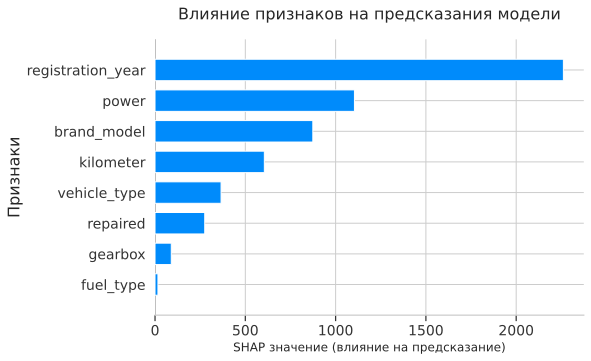

In [51]:
shap_plot(shap_values, X_test)

- ***Наибольшее влияние на предсказание модели оказывает признак `registration_year`. Меньше всего `fuel_type`***

<a id="conclusion"></a>
## Выводы:
### Предобработка
- ***В результате предобработки были переименованы столбцы, обработаны неявные дубли. Заполнены пропущенные значения значениями 'unknown'. Обработаны анмальные значения. Удалены неинформативные признаки.***

`Количество полных дубликатов в исходном датафрейме: 45040`

`Пропуски в исходном датафрейме:`

| Признак       | Кол-во пропусков | Процент пропусков |
|:--------------|-----------------:|------------------:|
| Repaired      |            71,154 |            20.08% |
| VehicleType   |            37,490 |            10.58% |
| FuelType      |            32,895 |             9.28% |
| Gearbox       |            19,833 |             5.60% |
| Model         |            19,705 |             5.56% |

### EDA
- ***В результате анализа составлен портрет наиболее популярного для продажи авто:***
    - Бензиновый volkswagen, bmw или opel
    - Средняя цена 1500 евро.
    - 2000 г. регистрации.
    - Мощностью 75 л. с.
    - На ручной коробке передач.
    - Не был в ремонте.
- ***Составлены рекомендации для бизнеса:***
    - Усовершенствовать сбор параметров авто (исключить повторения, неверное заполнение параметров, пропуски)
    - Не собирать неинформативные данные для анализа.
    - Параметр NumberOfPictures содержал только 0. Выявить проблему.
### Моделирование
- ***Рассмотрены 4 модели LightGBM, KNeighborsRegressor, LinearRegression, DecisionTreeRegressor.***

In [54]:
best_results.abs()

,fit_time,score_time,RMSE
model_name,,,
LGBMRegressor,60.6838,5.3400,1623.3766
KNeighborsRegressor,0.0777,0.9188,1919.7275
DecisionTreeRegressor,0.3809,0.0252,2049.3274
LinearRegression,1.5314,0.1128,2322.1068


- ***В результате выбрана модель LightGBM как баланс между точностью и скоростью:***

In [52]:
best_results[['fit_time', 'score_time']].head(1)

,fit_time,score_time
model_name,,
LGBMRegressor,60.6838,5.3400


In [53]:
print(f'RMSE модели {best_model} на тестовой выборке: {round(rmse, 2)}')

RMSE модели LGBMRegressor на тестовой выборке: 1558.15


- ***Наибольшее влияние на предсказание модели оказывает признак `registration_year`. Меньше всего `fuel_type`***
- ***В качестве финальной модели выбрана LGBMRegressor, т.к. она дает наиболее точное предсказание, время предсказания не выглядит критически большим. Однако, модель KNeighborsRegressor легче интерпретировать и если заказчику будет важнее скорость обучения и предсказания, то можно использовать ее. Модели LinearRegression, DecisionTreeRegressor так же имеют RMSE удовлетворяющий условию, но чуть ниже, чем KNeighborsRegressor.***

---

### Рекомендации для бизнеса:
- Усовершенствовать сбор параметров авто (исключить повторения, неверное заполнение параметров, пропуски).
- Ввести обязательные для заполнения поля.
- Не собирать неинформативные данные для анализа.
- Параметр NumberOfPictures содержал только 0. Выявить проблему.
- Возможно собрать дополнительные характеристики авто, которые могут положительно повлиять на предсказание стоимости (например: условия экстплуатации, как часто проходило ТО, количество владельцев).
- В дальнейшем можно увеличить количество подбираемых гиперпараметров модели.
- Использовать FeatureEngeneering для генерации новых признаков.